In [ ]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.nn.utils import spectral_norm
from torch.utils.data import DataLoader

# Set random seed for reproducibility
manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [ ]:
dataroot = "dataset"

workers = 6

batch_size = 256

image_size = 64

nc = 3

nz = 100

ngf = 64

ndf = 64

num_epochs = 200

lr = 0.0002

beta1 = 0.5

ngpu = 1

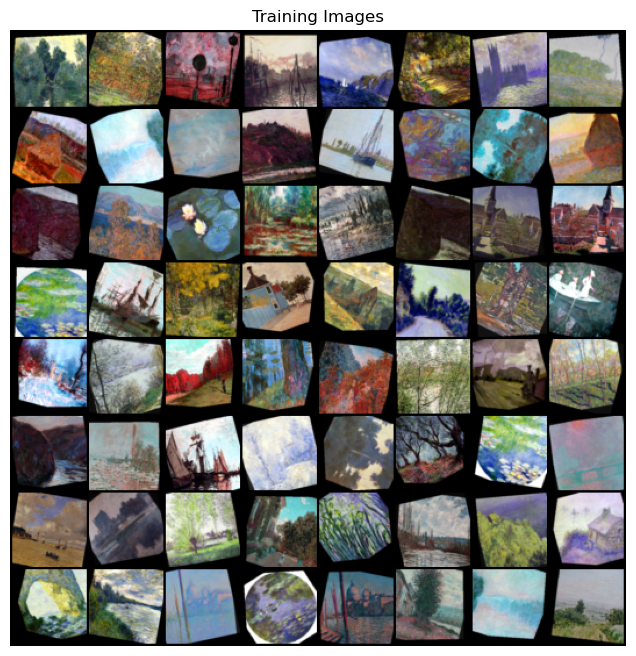

In [ ]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device("mps" if (torch.backends.mps.is_available() and ngpu > 0) else "cpu")

real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [4]:
# # device = torch.device("mps:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
# device = torch.device("mps" if (torch.backends.mps.is_available() and ngpu > 0) else "cpu")
# device

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netG = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            # input is ``(nc) x 64 x 64``
            spectral_norm(nn.Conv2d(nc, ndf, 4, 2, 1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            # state size. ``(ndf) x 32 x 32``
            spectral_norm(nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            # state size. ``(ndf*2) x 16 x 16``
            spectral_norm(nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            # state size. ``(ndf*4) x 8 x 8``
            spectral_norm(nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            # state size. ``(ndf*8) x 4 x 4``
            spectral_norm(nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False)),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netD = Discriminator(ngpu).to(device)

if (device.type == 'mps') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Dropout(p=0.3, inplace=False)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Dropout(p=0.3, inplace=False)
    (7): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Dropout(p=0.3, inplace=False)
    (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (13): LeakyReLU(negative_slope=0.2, inplace=True)
    (14)

In [ ]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 0.9
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr*0.5, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
threshold = 0.55
patience = 5000
counter = 0
max_counter = patience

img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

     
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

        if (abs(D_x - 0.5) <= 0.05) and (abs(D_G_z1 - 0.5) <= 0.05):
            counter += 1
            print(f"Discriminator outputs approaching 0.5 for {counter} iterations.")
            if counter >= max_counter:
                print(f"Early stopping triggered at epoch {epoch}, batch {i}.")
                break
        # else:
        #     counter = 0  # Reset counter if condition not met

        iters += 1

        if counter >= max_counter:
            break  # Exit outer epoch loop

Starting Training Loop...
[0/200][0/409]	Loss_D: 1.7601	Loss_G: 1.7435	D(x): 0.5955	D(G(z)): 0.6444 / 0.1794
[0/200][50/409]	Loss_D: 1.1860	Loss_G: 4.7813	D(x): 0.4862	D(G(z)): 0.0552 / 0.0119
[0/200][100/409]	Loss_D: 1.0530	Loss_G: 2.8525	D(x): 0.6026	D(G(z)): 0.2670 / 0.0673
[0/200][150/409]	Loss_D: 0.8204	Loss_G: 3.8183	D(x): 0.5726	D(G(z)): 0.1189 / 0.0206
[0/200][200/409]	Loss_D: 0.6755	Loss_G: 3.9848	D(x): 0.7802	D(G(z)): 0.1626 / 0.0177
[0/200][250/409]	Loss_D: 0.6523	Loss_G: 4.5004	D(x): 0.8277	D(G(z)): 0.1501 / 0.0089
[0/200][300/409]	Loss_D: 0.6807	Loss_G: 2.8036	D(x): 0.7001	D(G(z)): 0.1147 / 0.0575
[0/200][350/409]	Loss_D: 1.2391	Loss_G: 3.5973	D(x): 0.6351	D(G(z)): 0.3960 / 0.0336
[0/200][400/409]	Loss_D: 1.2238	Loss_G: 2.5781	D(x): 0.6277	D(G(z)): 0.3225 / 0.0850
[1/200][0/409]	Loss_D: 1.2377	Loss_G: 2.3027	D(x): 0.5224	D(G(z)): 0.2798 / 0.1237
[1/200][50/409]	Loss_D: 0.9874	Loss_G: 2.3876	D(x): 0.6085	D(G(z)): 0.2406 / 0.1066
[1/200][100/409]	Loss_D: 0.9997	Loss_G: 2.278

KeyboardInterrupt: 

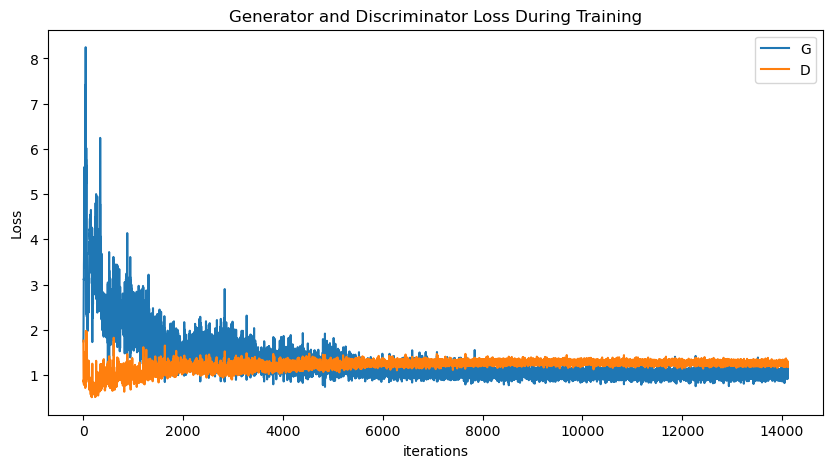

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21590711 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


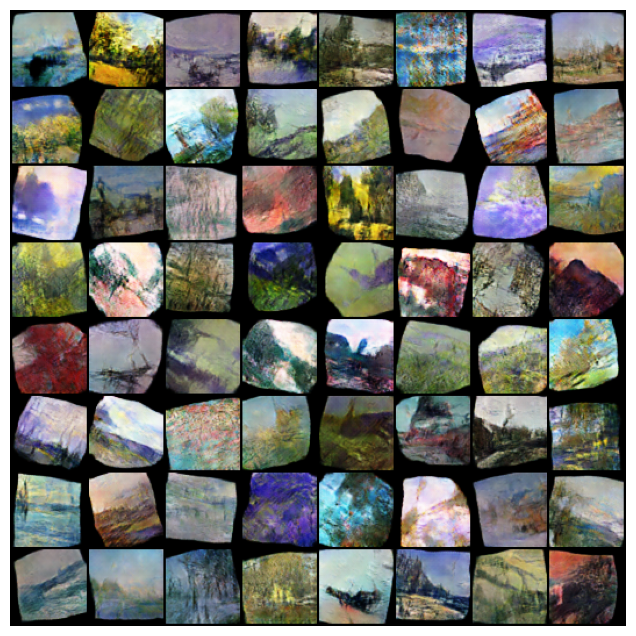

In [13]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
generator_save_path = 'dcgan_generator.pth'
discriminator_save_path = 'dcgan_discriminator.pth'
torch.save(netG.state_dict(), generator_save_path)
print(f"Generator model saved to {generator_save_path}")

torch.save(netD.state_dict(), discriminator_save_path)
print(f"Discriminator model saved to {discriminator_save_path}")


Generator model saved to dcgan_generator.pth
Discriminator model saved to dcgan_discriminator.pth


In [ ]:
import torchvision.utils as utils
generated_dir = "generated_images_fid"  

os.makedirs(generated_dir, exist_ok=True)

def generate_and_save_images(generator, num_images, save_dir, nz, device):
    generator.eval()
    num_batches = num_images // batch_size + (1 if num_images % batch_size != 0 else 0)
    print(f"Generating {num_images} images in {num_batches} batches...")

    with torch.no_grad():
        for batch_idx in range(num_batches):
            current_batch_size = min(batch_size, num_images - batch_idx * batch_size)
            noise = torch.randn(current_batch_size, nz, 1, 1, device=device)
            fake_images = generator(noise)
            # Denormalize images from [-1,1] to [0,1]
            fake_images = (fake_images + 1) / 2
            for i in range(fake_images.size(0)):
                img = fake_images[i].cpu()
                img_path = os.path.join(save_dir, f"generated_{batch_idx * batch_size + i + 1}.png")
                utils.save_image(img, img_path)
            print(f"Batch {batch_idx+1}/{num_batches} generated and saved.")
    print("Image generation completed.")

generate_and_save_images(netG, 5000, generated_dir, nz, device)


Generating 5000 images in 20 batches...
Batch 1/20 generated and saved.
Batch 2/20 generated and saved.
Batch 3/20 generated and saved.
Batch 4/20 generated and saved.
Batch 5/20 generated and saved.
Batch 6/20 generated and saved.
Batch 7/20 generated and saved.
Batch 8/20 generated and saved.
Batch 9/20 generated and saved.
Batch 10/20 generated and saved.
Batch 11/20 generated and saved.
Batch 12/20 generated and saved.
Batch 13/20 generated and saved.
Batch 14/20 generated and saved.
Batch 15/20 generated and saved.
Batch 16/20 generated and saved.
Batch 17/20 generated and saved.
Batch 18/20 generated and saved.
Batch 19/20 generated and saved.
Batch 20/20 generated and saved.
Image generation completed.


In [40]:
!pip install pytorch-fid

In [41]:
# Path to the directory containing real images
real_dir = "./dataset/augmented_images"

# Path to the directory containing generated images
generated_dir = "./generated_images_fid"


In [42]:
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

In [ ]:
from pytorch_fid import fid_score

fid_value = fid_score.calculate_fid_given_paths(
    paths=[real_dir, generated_dir],
    batch_size=50,                
    device=device,
    dims=2048                     
)

print(f"FID Score: {fid_value}")

100%|██████████| 100/100 [00:17<00:00,  5.57it/s]


FID Score: 162.81441100666137
